In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision.utils as vutils
import matplotlib.pyplot as plt

from discriminator import Discriminator
from generator import Generator

from torch.utils.data import DataLoader, Dataset


from utils import *
import torchvision
from torchvision import transforms

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [2]:

def visualize(dataloader, netG, netD, criterion, epoch, fixed_noise, device):
    for real_batch in dataloader:
        break
    y_labels = real_batch[1].to(device)
    real_batch = real_batch[0].to(device)
    
    batch_size = real_batch.size(0)
    label = torch.full((batch_size,), 1.0, device=device)
    output = netD(real_batch, y_labels).view(-1)
    errD_real = criterion(output, label)
    D_x = output.mean().item()

    fake = netG(fixed_noise, y_labels)
    label.fill_(0.0)
    output = netD(fake.detach(), y_labels).view(-1)
    errD_fake = criterion(output, label)
    D_G_z1 = output.mean().item()

    errD = errD_real + errD_fake

    label.fill_(1.0)
    output = netD(fake, y_labels).view(-1)
    errG = criterion(output, label)
    D_G_z2 = output.mean().item()

    print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
          % (epoch, 100, 0, len(dataloader),
             errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    

    fake = netG(fixed_noise, y_labels)
    

    # Plot the fake images from the last epoch

    fake = (fake - fake.min())/ (fake.max() - fake.min())
    # for row in range(8):
    #     for col in range(8):
    #         plt.subplot(8, 8, row*8+col+1)
    #         plt.axis("off")
    #         # set subplot label to be the label of the image
    #         plt.title(y_labels[row*8+col].item())
    #         # make title fit properly
    #         plt.subplots_adjust(top=1.5)
    #         # correct for mean 0 and std 1
    #         # unnormalize
    #         # adjust to 0 to 1 range
    #         plt.imshow(fake[row*8+col].detach().cpu().numpy().transpose(1,2,0), cmap='gray')

    return fake

In [3]:

IMG_SIZE = 32
fixed_noise = torch.randn(64, 100, 1, 1, device=device)
img_list = []
import glob
for checkpointD, checkpointG in sorted(list(zip(glob.glob("/ssd_scratch/cvit/anirudhkaushik/checkpoints/bganD_checkpoint_*.pt"),glob.glob("/ssd_scratch/cvit/anirudhkaushik/checkpoints/bganG_checkpoint_*.pt")))):
    print("epoch :" + checkpointD.split("_")[-2].split(".")[0])
    
    checkpointD = torch.load(checkpointD)
    checkpointG = torch.load(checkpointG)
    modelG = Generator(IMG_SIZE=32, img_ch=3)
    modelD = Discriminator(img_channels=3, n_classes=10)
    modelG.load_state_dict(checkpointG['model'])
    modelD.load_state_dict(checkpointD['model'])

    modelG = modelG.to(device)
    modelD = modelD.to(device)



    data_transforms = transforms.Compose([
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5], std=[0.5])

    ])
    train = torchvision.datasets.CIFAR10(root='/ssd_scratch/cvit/anirudhkaushik/datasets/', train=True, download=False, transform=data_transforms)
    test = torchvision.datasets.CIFAR10(root='/ssd_scratch/cvit/anirudhkaushik/datasets/', train=False, download=False, transform=data_transforms)

    data_loader = DataLoader(torch.utils.data.ConcatDataset([train, test]), batch_size=64, shuffle=True)


    # visualize
    criterion = nn.BCELoss()

    fake = visualize(data_loader, modelG, modelD, criterion, 0, fixed_noise, device)
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))


epoch :0
[0/100][0/938] Loss_D: 2.3066 Loss_G: 0.2676 D(x): 0.7548 D(G(z)): 0.7859 / 0.7859
epoch :10
[0/100][0/938] Loss_D: 0.1162 Loss_G: 3.1808 D(x): 0.9576 D(G(z)): 0.0660 / 0.0660
epoch :11
[0/100][0/938] Loss_D: 0.3791 Loss_G: 1.8859 D(x): 0.8909 D(G(z)): 0.2104 / 0.2104
epoch :12
[0/100][0/938] Loss_D: 0.1917 Loss_G: 2.2431 D(x): 0.9749 D(G(z)): 0.1439 / 0.1439
epoch :13
[0/100][0/938] Loss_D: 0.5991 Loss_G: 2.8657 D(x): 0.6442 D(G(z)): 0.0884 / 0.0884
epoch :14
[0/100][0/938] Loss_D: 1.2591 Loss_G: 0.4869 D(x): 0.9876 D(G(z)): 0.6505 / 0.6505
epoch :15
[0/100][0/938] Loss_D: 2.0278 Loss_G: 0.2710 D(x): 0.9923 D(G(z)): 0.7984 / 0.7984
epoch :16
[0/100][0/938] Loss_D: 0.0115 Loss_G: 4.9511 D(x): 0.9986 D(G(z)): 0.0100 / 0.0100
epoch :17
[0/100][0/938] Loss_D: 0.0040 Loss_G: 7.6520 D(x): 0.9971 D(G(z)): 0.0010 / 0.0010
epoch :18
[0/100][0/938] Loss_D: 0.3817 Loss_G: 2.4215 D(x): 0.8176 D(G(z)): 0.1340 / 0.1340
epoch :19
[0/100][0/938] Loss_D: 0.2957 Loss_G: 5.5241 D(x): 0.7783 D(G

Animation size has reached 21471946 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


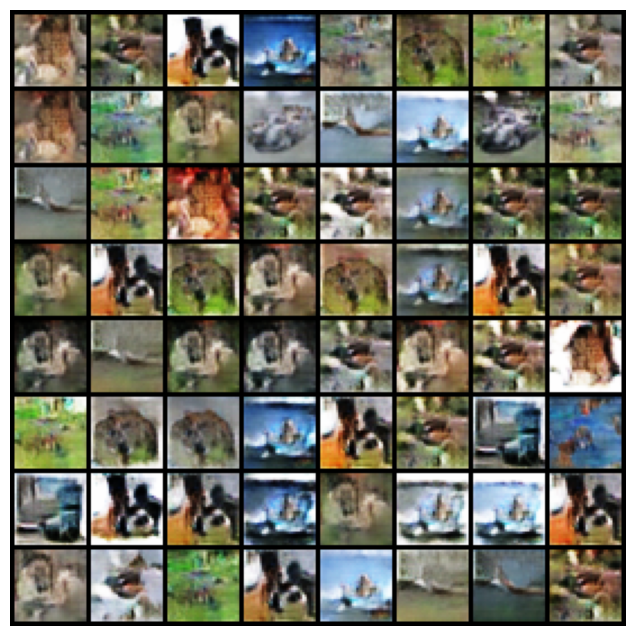

In [8]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
for i in range(len(img_list)):
    img_list[i] = img_list[i].cpu().detach().numpy()
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())